In [1]:
import pandas as pd
import numpy as np
import chess
from chess import pgn
from chess import Board
import archives_manager
from pawn_structure_analysis import PawnStructureAnalysis
import io

pd.set_option('display.max_rows', None)
pd.set_option('display.width', 10000)

In [2]:
player_name = "BIG_TONKA_T"
start_unix = 1696176000 # oct 1st 2023
end_unix = 1698768000 # same time, oct 31st 2023

game_archive = archives_manager.get_games_between_timestamps(player_name, start_unix, end_unix, time_class='rapid', filter_func=archives_manager.build_archive_filter(
    rated=True
))

In [4]:
game_info = []
pawn_structure_features = []

for i in range(len(game_archive)):
    game = game_archive[i]
    won = archives_manager.get_won(game, player_name)
    color = archives_manager.get_color(game, player_name)
    pawn_structure_analysis = PawnStructureAnalysis(Board())
    game_pgn = game['pgn']
    chess_game = pgn.read_game(io.StringIO(game_pgn))

    total_move_count = 0
    for move in chess_game.mainline_moves():
        total_move_count += 1

    move_count = 0

    for move in chess_game.mainline_moves():
        move_count += 1
        game_percentage = move_count / total_move_count

        white_pawns = pawn_structure_analysis.count_pawns(chess.WHITE)
        black_pawns = pawn_structure_analysis.count_pawns(chess.BLACK)
        white_shiftness, white_shiftness_var = pawn_structure_analysis.calculate_shiftness(chess.WHITE)
        black_shiftness, black_shiftness_var = pawn_structure_analysis.calculate_shiftness(chess.BLACK)
        white_forwardness, white_forwardness_var = pawn_structure_analysis.calculate_forwardness(chess.WHITE)
        black_forwardness, black_forwardness_var = pawn_structure_analysis.calculate_forwardness(chess.BLACK)
        white_isolated_pawns = pawn_structure_analysis.count_isolated_pawns(chess.WHITE)
        black_isolated_pawns = pawn_structure_analysis.count_isolated_pawns(chess.BLACK)
        blockades = pawn_structure_analysis.count_blockades()
        tension = pawn_structure_analysis.measure_tension()
        white_passed_pawns = pawn_structure_analysis.count_passed_pawns(chess.WHITE)
        black_passed_pawns = pawn_structure_analysis.count_passed_pawns(chess.BLACK)
        white_doubled_pawns = pawn_structure_analysis.count_doubled_pawns(chess.WHITE)
        black_doubled_pawns = pawn_structure_analysis.count_doubled_pawns(chess.BLACK)
        open_files = pawn_structure_analysis.count_open_files()
        semi_open_black_files = pawn_structure_analysis.count_semi_open_black_files()
        semi_open_white_files = pawn_structure_analysis.count_semi_open_white_files()
        closed_files = pawn_structure_analysis.count_closed_files()

        game_info.append({
            # info
            'game_number': i,
            'game_percentage': game_percentage,
            'won': won,
            'color': color,
            'to_move': pawn_structure_analysis.board.turn,
            'is_player_turn': pawn_structure_analysis.board.turn == color
        })

        pawn_structure_features.append({
            # features
            'white_pawns': white_pawns,
            'black_pawns': black_pawns,
            'white_shiftness': white_shiftness,
            'white_shiftness_var': white_shiftness_var,
            'black_shiftness': black_shiftness,
            'black_shiftness_var': black_shiftness_var,
            'white_forwardness': white_forwardness,
            'white_forwardness_var': white_forwardness_var,
            'black_forwardness': black_forwardness,
            'black_forwardness_var': black_forwardness_var,
            'white_isolated_pawns': white_isolated_pawns,
            'black_isolated_pawns': black_isolated_pawns,
            'blockades': blockades,
            'tension': tension,
            'white_passed_pawns': white_passed_pawns,
            'black_passed_pawns': black_passed_pawns,
            'white_doubled_pawns': white_doubled_pawns,
            'black_doubled_pawns': black_doubled_pawns,
            'open_files': open_files,
            'semi_open_black_files': semi_open_black_files,
            'semi_open_white_files': semi_open_white_files,
            'closed_files': closed_files
        })

        pawn_structure_analysis.push_move(move)

pawn_structure_df = pd.DataFrame(pawn_structure_features)
game_info_df = pd.DataFrame(game_info)

print(game_info_df, '\n\n\n')
print(pawn_structure_df)

       game_number  game_percentage  won  color  to_move  is_player_turn
0                0         0.021277  1.0  False     True           False
1                0         0.042553  1.0  False    False            True
2                0         0.063830  1.0  False     True           False
3                0         0.085106  1.0  False    False            True
4                0         0.106383  1.0  False     True           False
5                0         0.127660  1.0  False    False            True
6                0         0.148936  1.0  False     True           False
7                0         0.170213  1.0  False    False            True
8                0         0.191489  1.0  False     True           False
9                0         0.212766  1.0  False    False            True
10               0         0.234043  1.0  False     True           False
11               0         0.255319  1.0  False    False            True
12               0         0.276596  1.0  False    

In [5]:
for column_name in pawn_structure_df.columns:
    print(pawn_structure_df[column_name].describe(), end='\n\n')

count    67246.000000
mean         6.041252
std          2.119227
min          0.000000
25%          5.000000
50%          7.000000
75%          8.000000
max          8.000000
Name: white_pawns, dtype: float64

count    67246.000000
mean         6.056271
std          2.135826
min          0.000000
25%          5.000000
50%          7.000000
75%          8.000000
max          8.000000
Name: black_pawns, dtype: float64

count    67246.000000
mean         0.018675
std          0.236171
min         -1.000000
25%         -0.020408
50%          0.000000
75%          0.047619
max          1.000000
Name: white_shiftness, dtype: float64

count    67246.000000
mean         0.408907
std          0.161663
min          0.000000
25%          0.406497
50%          0.428571
75%          0.486464
max          1.000000
Name: white_shiftness_var, dtype: float64

count    67246.000000
mean        -0.017484
std          0.230701
min         -1.000000
25%         -0.035714
50%          0.000000
75%         

In [6]:
# copy the dataframe and make a standardized version for the features
pawn_structure_df_std = pawn_structure_df.copy()
pawn_structure_df_std = (pawn_structure_df_std - pawn_structure_df_std.mean()) / pawn_structure_df_std.std()
print(pawn_structure_df_std.head())
print(pawn_structure_df_std.describe())

   white_pawns  black_pawns  white_shiftness  white_shiftness_var  black_shiftness  black_shiftness_var  white_forwardness  white_forwardness_var  black_forwardness  black_forwardness_var  ...  blockades   tension  white_passed_pawns  black_passed_pawns  white_doubled_pawns  black_doubled_pawns  open_files  semi_open_black_files  semi_open_white_files  closed_files
0     0.924275      0.91006        -0.079072             0.121638         0.075786             0.158487          -1.251365              -1.140024          -1.171038              -1.067326  ...  -0.728262 -0.330099           -0.400146           -0.405184            -0.323348            -0.341927   -0.718107              -0.843631              -0.836424        1.1155
1     0.924275      0.91006        -0.079072             0.121638         0.075786             0.158487          -1.251365              -1.140024          -1.171038              -1.067326  ...  -0.728262 -0.330099           -0.400146           -0.405184           

In [7]:
print(len(game_info_df[game_info_df['won'] == 1]))
print(len(game_info_df[game_info_df['won'] == 0]))

32876
28679


In [30]:
from sklearn.decomposition import PCA

pca = PCA(n_components=5)
pca_result = pca.fit_transform(pawn_structure_df_std)

print(pca.explained_variance_ratio_)
print(np.cumsum(pca.explained_variance_ratio_))

# Get the PCA components
components = pca.components_

# Get the feature names from the DataFrame
feature_names = pawn_structure_df_std.columns

# Iterate over each component
for i, component in enumerate(components):
    # Map the component weights to the feature names
    # and sort them by absolute value
    component_weights = dict(zip(feature_names, component))
    sorted_weights = sorted(component_weights.items(), key=lambda x: abs(x[1]), reverse=True)
    
    # Print the top 5 features
    print(f"Top 5 predictors for Principal Component {i+1}:")
    for feature, weight in sorted_weights[:5]:
        print(f"{feature}: {weight}")
    print()


[0.27309581 0.10785545 0.08615666 0.07063487 0.06213191]
[0.27309581 0.38095126 0.46710792 0.53774279 0.5998747 ]
Top 5 predictors for Principal Component 1:
closed_files: -0.3938005594633621
white_pawns: -0.36940250938435104
black_pawns: -0.3692087742355912
open_files: 0.3362278264320472
semi_open_black_files: 0.22876275332189278

Top 5 predictors for Principal Component 2:
blockades: 0.3662813092212431
white_forwardness_var: 0.3503450229108387
black_forwardness_var: 0.3492544207033954
black_doubled_pawns: 0.25574068060728006
open_files: -0.252030701190599

Top 5 predictors for Principal Component 3:
white_passed_pawns: 0.44186227358536107
black_passed_pawns: -0.4368413920472902
semi_open_white_files: -0.34206110726421934
semi_open_black_files: 0.33449000231420606
white_forwardness_var: 0.3195132245714094

Top 5 predictors for Principal Component 4:
blockades: -0.45484302712937913
white_isolated_pawns: 0.35803642198432556
white_shiftness_var: 0.3054024866058035
semi_open_white_files: 

In [11]:
'''def view_df(structure_df, info_df, color, won, is_player_turn):
    info_view = info_df[info_df['color'] == color][info_df['won'] == won][info_df['is_player_turn']]
    structure_df_view = structure_df[info_view.index]
    return info_view, structure_df_view'''

def view_df(structure_df, info_df, color, won, is_player_turn):
    condition = (info_df['color'] == color) & (info_df['won'] == won) & (info_df['is_player_turn'] == is_player_turn)
    info_view = info_df[condition]

    if info_view.empty:
        print("No matching data found.")
        return None, None

    structure_df_view = structure_df.loc[info_view.index]

    return info_view, structure_df_view


In [13]:
info_view, structure_view = view_df(pawn_structure_df_std, game_info_df, chess.WHITE, won=True, is_player_turn=True)

print(info_view)

       game_number  game_percentage  won  color  to_move  is_player_turn
47               1         0.010753  1.0   True     True            True
49               1         0.032258  1.0   True     True            True
51               1         0.053763  1.0   True     True            True
53               1         0.075269  1.0   True     True            True
55               1         0.096774  1.0   True     True            True
57               1         0.118280  1.0   True     True            True
59               1         0.139785  1.0   True     True            True
61               1         0.161290  1.0   True     True            True
63               1         0.182796  1.0   True     True            True
65               1         0.204301  1.0   True     True            True
67               1         0.225806  1.0   True     True            True
69               1         0.247312  1.0   True     True            True
71               1         0.268817  1.0   True    

In [14]:
print(structure_view)

       white_pawns  black_pawns  white_shiftness  white_shiftness_var  black_shiftness  black_shiftness_var  white_forwardness  white_forwardness_var  black_forwardness  black_forwardness_var  ...  blockades   tension  white_passed_pawns  black_passed_pawns  white_doubled_pawns  black_doubled_pawns  open_files  semi_open_black_files  semi_open_white_files  closed_files
47        0.924275     0.910060        -0.079072             0.121638         0.075786             0.158487          -1.251365              -1.140024          -1.171038              -1.067326  ...  -0.728262 -0.330099           -0.400146           -0.405184            -0.323348            -0.341927   -0.718107              -0.843631              -0.836424      1.115500
49        0.924275     0.910060        -0.079072             0.121638         0.075786             0.158487          -1.054150              -0.970912          -0.790819              -0.390998  ...  -0.728262 -0.330099           -0.400146           -0.40518

In [38]:
import matplotlib.pyplot as plt
from cmyt import pixel_red

def pca_plot(score, coeff, feature_arrows=False, feature_labels=None, padding=0.15,scatter_color='blue', scatter_cmap=None, scatter_color_label=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    plt.scatter(xs * scalex, ys * scaley, c=scatter_color, cmap=scatter_cmap, alpha=1, zorder=4, s=7)
    if scatter_cmap:
        plt.colorbar(label=scatter_color_label)
    for i in range(n):
        if feature_arrows:
            plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = 'r',alpha = 1, zorder=5)
        if feature_labels is not None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, feature_labels[i], color = 'black', ha = 'center', va = 'center', zorder=6)
    #plt.xlim(-1/zoom,1/zoom)
    #plt.ylim(-1/zoom,1/zoom)
    #x_lim = max(abs(min(xs) * scalex), abs(max(xs) * scalex))
    #y_lim = max(abs(min(ys) * scaley), abs(max(ys) * scaley))
    #plt.xlim(-x_lim - padding, x_lim + padding)
    #plt.ylim(-y_lim - padding, y_lim + padding)
    plt.xlim(-0.8, 0.8)
    plt.ylim(-0.8, 0.8)
    plt.xlabel("PC{}".format(1))
    plt.ylabel("PC{}".format(2))
    plt.grid(zorder=3)

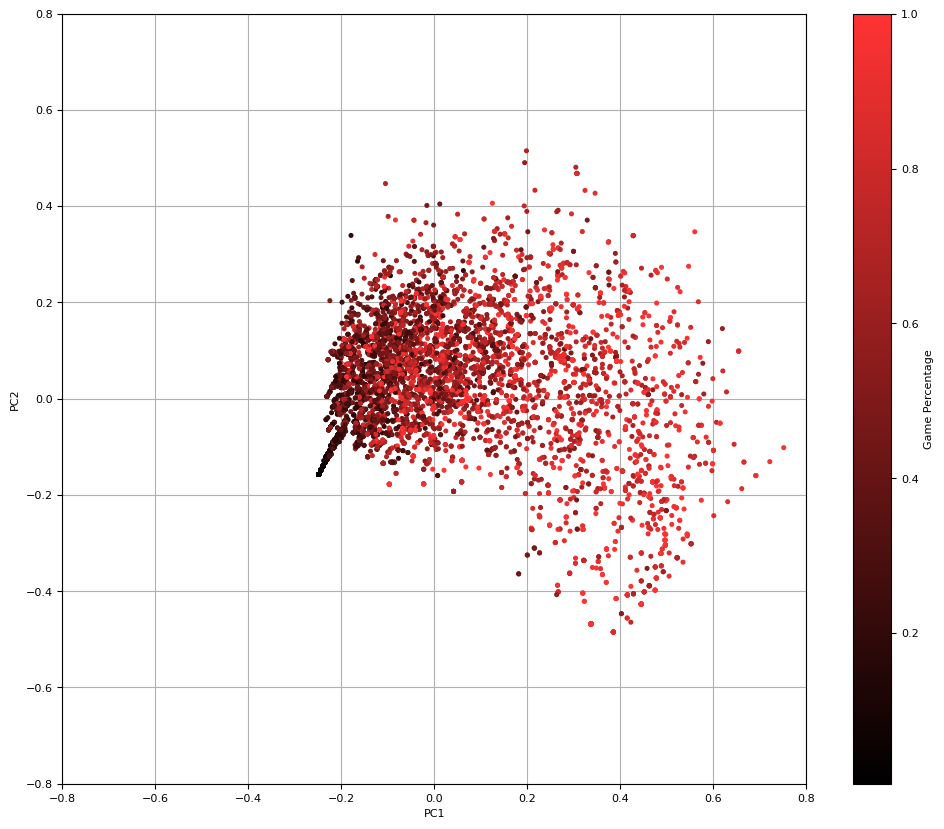

In [45]:
info_view, structure_view = view_df(pawn_structure_df_std, game_info_df, chess.WHITE, won=True, is_player_turn=True)

plt.figure(figsize=(12, 10))
plt.rcParams.update({'font.size': 8})

pca_plot(
    pca_result[info_view.index,0:2],
    np.transpose(pca.components_[0:2, :]),
    feature_arrows=False,
    #feature_labels=pawn_structure_df_std.columns,
    feature_labels=None,
    padding=0.15,
    scatter_color=info_view['game_percentage'],
    scatter_cmap=pixel_red,
    scatter_color_label='Game Percentage'
)
plt.show()

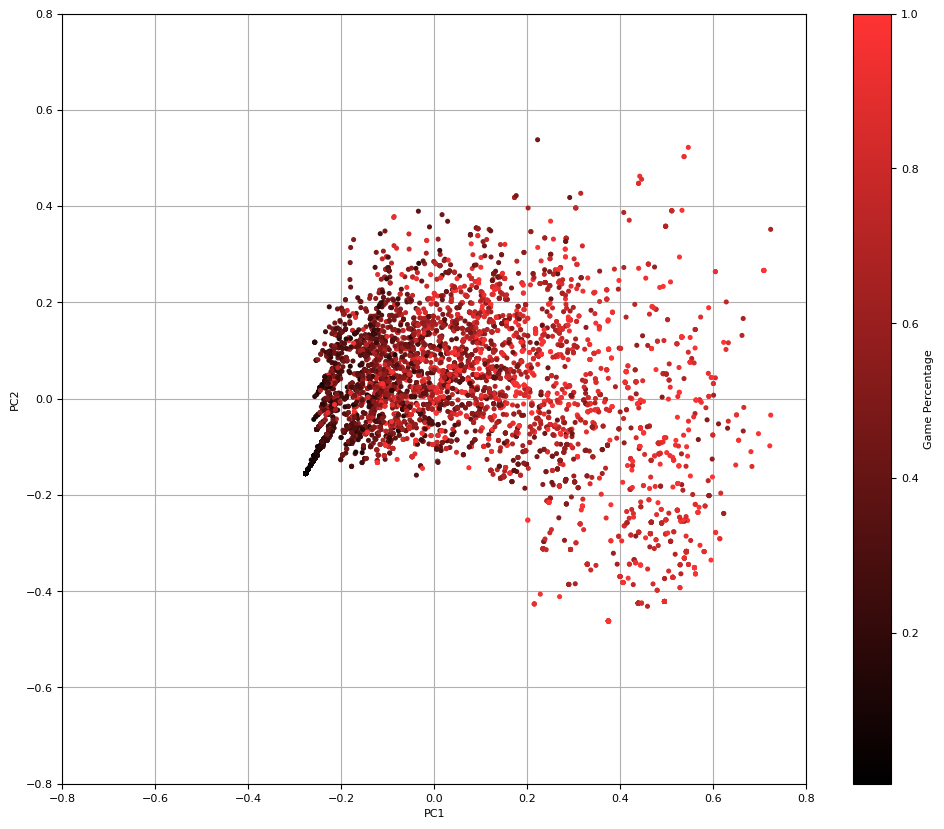

In [46]:
info_view, structure_view = view_df(pawn_structure_df_std, game_info_df, chess.WHITE, won=False, is_player_turn=True)

plt.figure(figsize=(12, 10))
plt.rcParams.update({'font.size': 8})

pca_plot(
    pca_result[info_view.index,0:2],
    np.transpose(pca.components_[0:2, :]),
    feature_arrows=False,
    #feature_labels=pawn_structure_df_std.columns,
    feature_labels=None,
    padding=0.15,
    scatter_color=info_view['game_percentage'],
    scatter_cmap=pixel_red,
    scatter_color_label='Game Percentage'
)
plt.show()